In [1]:
import pandas as pd
import geopandas as gpd
import folium
import requests
import folium.plugins as plugins

# Preparo datos do dataframe de airbnb

In [2]:
airbnb = pd.read_csv('airbnb/AB_NYC_2019.csv')

airbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [3]:
len(airbnb)

48895

In [4]:
airbnb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

In [5]:
#Comprobo se ten nulos

airbnb.isnull().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

In [6]:
#Comprobo se ten filas duplicadas

print(f'Filas duplicadas = {airbnb.duplicated().sum()}')

Filas duplicadas = 0


In [7]:
#Elimino as filas nas que o nome é nulo

airbnb.drop(airbnb[airbnb.name.isna()].index, axis = 0, inplace = True)
airbnb.drop(airbnb[airbnb.host_name.isna()].index, axis = 0, inplace = True)

In [8]:
#Reseteo o ínidce para que non falten os valores das filas que eliminei

airbnb.reset_index(drop=True, inplace=True)

In [9]:
#Creo un dataframe só cos datos que me interesan dos airbnb

airbnb_final = airbnb[['host_name', 'neighbourhood_group', 'latitude', 'longitude', 'price', 'number_of_reviews']]

airbnb_final.head()

,host_name,neighbourhood_group,latitude,longitude,price,number_of_reviews
0,John,Brooklyn,40.64749,-73.97237,149,9
1,Jennifer,Manhattan,40.75362,-73.98377,225,45
2,Elisabeth,Manhattan,40.80902,-73.94190,150,0
3,LisaRoxanne,Brooklyn,40.68514,-73.95976,89,270
4,Laura,Manhattan,40.79851,-73.94399,80,9


# Preparo os datos do metro

## Datos extraidos do csv 

Estos datos o final non os utilizo porque tiñan moitas coordenadas duplicadas


In [10]:
# metro = pd.read_csv('metro/rows.csv')

# metro.head()

In [11]:
# metro.columns

In [12]:
# len(metro)

In [13]:
# metro.info()

In [14]:
#Comprobo se ten nulos

# metro.isnull().sum()

In [15]:
#Comprobo se ten filas duplicadas

# print(f'Filas duplicadas = {metro.duplicated().sum()}')

In [16]:
#Comprobo se ten filas duplicadas
# metro['Station Latitude'].duplicated().sum()

In [17]:
#Creo un dataframe só cos datos que me interesan dos airbnb
#!!!!!!!!!!!!
#No dataset das estacións de metro a lonxitude a e latitude están invertidas, polo cambio os nomes das columnas

# metro_final = metro[['Line', 'Station Longitude', 'Station Latitude', 'Entry']]

# metro_final.rename(columns = {"Station Longitude": "Latitude", "Latitude": "Station Longitude"})

# metro_final.head()

## Datos do metro extraidos de geojson

In [18]:
metro = gpd.read_file('metro/Subway Stations.geojson')

In [19]:
metro.head()

,name,url,line,objectid,notes,geometry
0,Astor Pl,http://web.mta.info/nyct/service/,4-6-6 Express,1,"4 nights, 6-all times, 6 Express-weekdays AM s...",POINT (-73.99107 40.73005)
1,Canal St,http://web.mta.info/nyct/service/,4-6-6 Express,2,"4 nights, 6-all times, 6 Express-weekdays AM s...",POINT (-74.00019 40.71880)
2,50th St,http://web.mta.info/nyct/service/,1-2,3,"1-all times, 2-nights",POINT (-73.98385 40.76173)
3,Bergen St,http://web.mta.info/nyct/service/,2-3-4,4,"4-nights, 3-all other times, 2-all times",POINT (-73.97500 40.68086)
4,Pennsylvania Ave,http://web.mta.info/nyct/service/,3-4,5,"4-nights, 3-all other times",POINT (-73.89489 40.66471)


<AxesSubplot:>

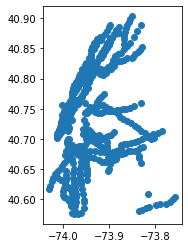

In [20]:
metro.plot()

In [21]:
linea_metro = gpd.read_file('metro/Subway Lines.geojson')

In [22]:
linea_metro.head()

,name,url,rt_symbol,objectid,id,shape_len,geometry
0,G,http://web.mta.info/nyct/service/,G,753,2000393,2438.20024902,"LINESTRING (-73.99488 40.68020, -73.99427 40.6..."
1,G,http://web.mta.info/nyct/service/,G,754,2000394,3872.83441063,"LINESTRING (-73.97958 40.65993, -73.97966 40.6..."
2,Q,http://web.mta.info/nyct/service/,N,755,2000469,1843.36633108,"LINESTRING (-73.97586 40.57597, -73.97654 40.5..."
3,M,http://web.mta.info/nyct/service/,B,756,2000294,1919.5592029,"LINESTRING (-73.92414 40.75229, -73.92405 40.7..."
4,M,http://web.mta.info/nyct/service/,B,757,2000296,2385.69853589,"LINESTRING (-73.91345 40.75617, -73.90905 40.7..."


<AxesSubplot:>

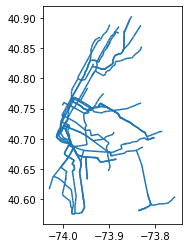

In [23]:
linea_metro.plot()

In [24]:
#Comprobo o crs do geopandas

linea_metro.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

# Preparo os datos dos hospitais

In [25]:
url = 'https://data.cityofnewyork.us/api/views/ymhw-9cz9/rows.json?accessType=DOWNLOAD'

response = requests.get(url)
response

<Response [200]>

In [26]:
json = response.json()

In [27]:
lista_datos = []

for i in json['data']:
    nombre = i[10]
    latitud = i[13][1]
    longitud = i[13][2]


    lista_datos.append([nombre, latitud, longitud])



In [28]:
hospitales = pd.DataFrame(lista_datos, columns=['Nombre', 'lat', 'long'])

hospitales.head()

,Nombre,lat,long
0,La Clinica Del Barrio,40.798205044469,-73.932667945174
1,Elmhurst Hospital Center,40.738710402563,-73.878351155182
2,Ida G. Israel Community Health Center,40.578488319967,-73.989497148121
3,South Queens Community Health Center,40.676945262114,-73.775306901692
4,Melrose Houses Child Health Clinic,40.821301194646,-73.917709787212


In [29]:
#Comprobo se hai udplicados

hospitales.Nombre.duplicated().sum()

16

In [30]:
#Elimino as filas nas que o nome é nulo

hospitales.drop(hospitales[hospitales.Nombre.isna()].index, axis = 0, inplace = True)

# Creo o mapa

In [31]:
m = folium.Map(location=[40,-73],zoom_start=8)

cont = 0
marcas_metro = []

cluster_airbnb = plugins.MarkerCluster(name = "Airbnb").add_to(m)
cluster_metro = plugins.MarkerCluster(name = "Metro").add_to(m)
cluster_hospital = plugins.MarkerCluster(name = "Hospitales").add_to(m)


for i,j in airbnb_final.iterrows():

    if cont == 20:
        break

    folium.Marker(location=[j[2],j[3]], icon=folium.Icon(color="orange",icon="fa-home", prefix="fa")).add_to(cluster_airbnb)

folium.GeoJson(linea_metro).add_to(cluster_metro)
folium.GeoJson(metro).add_to(cluster_metro)



for i,j in hospitales.iterrows():
    # print(j)

    # cont += 1

    if cont == 20:
        break

    folium.Marker(location=[j[1],j[2]], tooltip=j[0], icon=folium.Icon(color="red",icon="fa-h-square", prefix="fa")).add_to(cluster_hospital)


folium.LayerControl().add_to(m)

m

In [32]:
m.save('mapa.html')